In [1]:
from PIL import Image
from glob import glob
import numpy as np
import cv2
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import re
import pydicom

In [14]:
import os
gt_img_home1 = r"C:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\imagesTr\*.png"
gt_img_home2 = r"C:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\imagesTs\*.png"
gt_mask_home1 = r"C:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTr\*.png"
gt_mask_home2 = r"C:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\*.png"

def change_name(name):
    number_part = re.search(r'\d+_', name).group()[:-1]
    number_part = int(number_part)
    new_filename = f"img-{number_part:05d}_0000.png"
    return new_filename

def change_mask_name(name):
    number_part = re.search(r'\d+_', name).group()[:-1]
    number_part = int(number_part)
    new_filename = f"img-{number_part:05d}.png"
    return new_filename

## NNUnet 에 맞게 img, mask 이름 변경

In [ ]:
# img_paths = glob(gt_img_home1)
# for path in img_paths:
#     fn = path.split("\\")[-1]
#     home = path.split("\\")[:-1]
#     new_fn = change_name(fn)
#     home.append(new_fn)
#     home = "\\".join(home)
#     os.rename(path, home)

In [12]:
# img_paths = glob(gt_img_home2)
# for path in img_paths:
#     fn = path.split("\\")[-1]
#     home = path.split("\\")[:-1]
#     new_fn = change_name(fn)
#     home.append(new_fn)
#     home = "\\".join(home)
#     os.rename(path, home)

In [15]:
# img_paths = glob(gt_mask_home1)
# for path in img_paths:
#     fn = path.split("\\")[-1]
#     home = path.split("\\")[:-1]
#     new_fn = change_mask_name(fn)
#     home.append(new_fn)
#     home = "\\".join(home)
#     os.rename(path, home)

In [ ]:
# img_paths = glob(gt_mask_home2)
# for path in img_paths:
#     fn = path.split("\\")[-1]
#     home = path.split("\\")[:-1]
#     new_fn = change_mask_name(fn)
#     home.append(new_fn)
#     home = "\\".join(home)
#     os.rename(path, home)

---

## 학습 시킨 모델 900개의 test 셋으로 predict한 결과

899


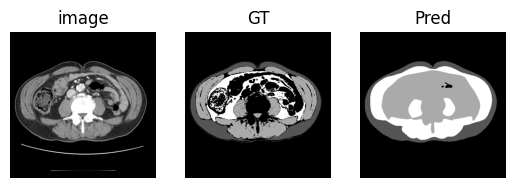

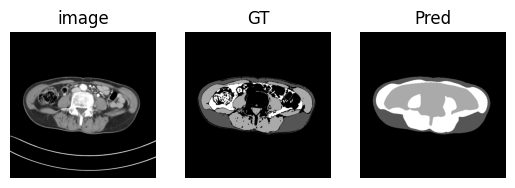

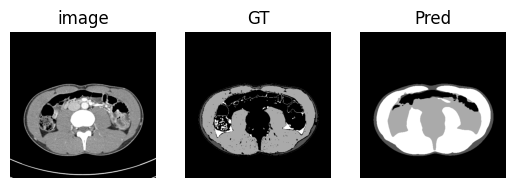

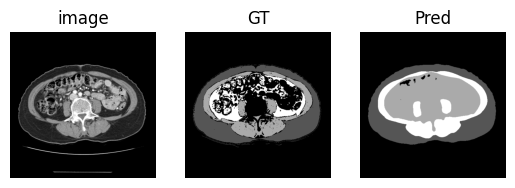

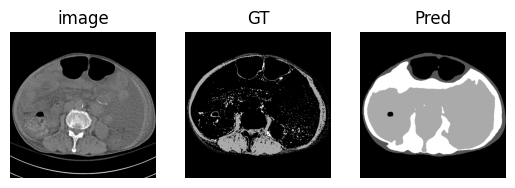

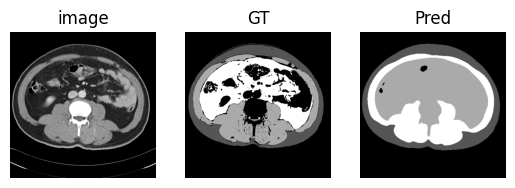

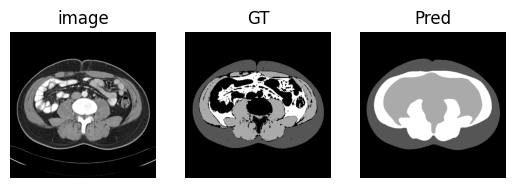

In [24]:
pred_mask_home=r'C:\Users\qwe14\0.code\nnUNet\nnUNet_results\Dataset122_MR\nnUNetTrainer__nnUNetPlans__2d\fold_5'
gt_mask_home=r"C:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs"
gt_img_home=r"C:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\imagesTs"

pred_mask_paths = glob(f"{pred_mask_home}\*.png")
gt_mask_paths = glob(f"{gt_mask_home}\*.png")
gt_img_paths = glob(f"{gt_img_home}\*.png")

idx = 0
print(len(pred_mask_paths))
for pmp, gmp, gip in zip(pred_mask_paths, gt_mask_paths, gt_img_paths):
    idx+=1
    if idx % 120 == 0:
        pm_mask = cv2.imread(pmp, cv2.IMREAD_GRAYSCALE)
        gm_mask = cv2.imread(gmp, cv2.IMREAD_GRAYSCALE)
        gt_image = cv2.imread(gip, cv2.IMREAD_GRAYSCALE)
        plt.subplot(1,3,1)
        plt.gca().set_title("image")
        plt.gca().axis("off")
        plt.imshow(gt_image.astype(np.float32), cmap = cm.gray)
        
        plt.subplot(1,3,2)
        plt.gca().set_title("GT")
        plt.gca().axis("off")
        plt.imshow(gm_mask.astype(np.float32), cmap = cm.gray) 
    
        plt.subplot(1,3,3)
        plt.gca().set_title("Pred")
        plt.gca().axis("off")
        plt.imshow(pm_mask.astype(np.float32), cmap = cm.gray)
        plt.show()

---
- 후처리 할 내용
    - 마스크의 순서 통일
        - 1:sfat 2: vfat 3:muscle
    - 원본 dcm 파일 얻어오기
        - C:\Users\qwe14\0.code\sarcopenia\data_test\data_relation.txt 에서 참고

## 후처리

### 원본 dcm 파일 얻어와 파일 위치 txt로 저장하기

In [2]:
def get_slice_no(raw_path):
    l3_dcm_id = None
    with open(raw_path, 'r', encoding="utf-8") as f:
        lines = f.readlines()
    for i, line in enumerate(lines):
        if line.strip() == "#SliceNo":
            l3_dcm_id = int(lines[i+1])
            return l3_dcm_id
    return l3_dcm_id


def get_testset_files():
    raw_data_home = r'C:\Users\qwe14\0.code\sarcopenia\data_train_raw\#AsanNas'
    test_mask_home = r"C:\Users\qwe14\0.code\sarcopenia\data_test\masks"
    rel_path = r'C:\Users\qwe14\0.code\sarcopenia\data_test\data_relation.txt'
    with open(rel_path, "r", encoding='utf-8') as f:
        lines = f.readlines()

    test_set_list = []
    for line in lines:
        try:
            dcm_parent, mask_file = line.strip().split("\t") #SarcopeniaCase1/20061220_DCM	00001_20061220.png
            dcm_raw_file = dcm_parent.replace("DCM", "RAW.txt")
            dcm_raw_path = f"{raw_data_home}\\{dcm_raw_file}"
            dcm_num = get_slice_no(dcm_raw_path)
            dcm_file = f"{dcm_num:05d}.dcm"
            dcm_path = f"{raw_data_home}\\{dcm_parent}\\{dcm_file}"
            mask_path = f"{test_mask_home}\\{mask_file}"
            temp = [dcm_path, mask_path]
            test_set_list.append(temp)
        except FileNotFoundError as e:
            pass
    return test_set_list

In [9]:
test_set = get_testset_files()
del test_set[614]

In [10]:
print(len(test_set))

900


In [5]:
print(test_set[0])

['C:\\Users\\qwe14\\0.code\\sarcopenia\\data_train_raw\\#AsanNas\\SarcopeniaCase1/20061220_DCM\\00040.dcm', 'C:\\Users\\qwe14\\0.code\\sarcopenia\\data_test\\masks\\00001_20061220.png']


In [11]:
# # 이상치 제거: dcm 파일이 없거나 등등
# for idx, (dcm, mask) in enumerate(test_set):
#     if "Case10\\" in dcm:
#         print(idx, dcm, mask)
#     elif "Case268" in dcm:
#         print(idx, dcm, mask)
#     elif "Case303" in dcm:
#         print(idx, dcm, mask)
#     elif "Case381" in dcm:
#         print(idx, dcm, mask)

##

In [18]:
from sklearn.metrics import f1_score, accuracy_score
def calculate_binary_metrics(pm_mask, gm_mask):
    f1_micro = f1_score(pm_mask.flatten(), gm_mask.flatten(), average='micro')
    f1_macro = f1_score(pm_mask.flatten(), gm_mask.flatten(), average='macro')
    accuracy = accuracy_score(pm_mask.flatten(), gm_mask.flatten())

    return f1_micro, f1_macro, accuracy
    
def calculate_iou(predicted_mask, ground_truth_mask):
    intersection = np.logical_and(predicted_mask, ground_truth_mask)
    union = np.logical_or(predicted_mask, ground_truth_mask)
    
    iou = np.sum(intersection) / np.sum(union)
    return iou

In [19]:
def norm_img(img):
    norm_image = np.array(img, dtype=np.float64)
    norm_image -= np.min(norm_image)
    norm_image /= np.max(norm_image)
    normalized_image = norm_image * 255
    normalized_image = normalized_image.astype(np.uint8)
    return normalized_image


def get_preprocess_dcm_img(dcm):
    dcm_array = dcm.pixel_array
    try:
        hu_image = dcm_array * dcm.RescaleSlope + dcm.RescaleIntercept
        img_min = dcm.WindowCenter - dcm.WindowWidth // 2
        img_max = dcm.WindowCenter + dcm.WindowWidth // 2
    except AttributeError:
        hu_image = dcm_array
        img_min = 40 - 200
        img_max = 40 + 200
    except TypeError:
        img_min = dcm.WindowCenter[0] - dcm.WindowWidth[0] // 2
        img_max = dcm.WindowCenter[0] + dcm.WindowWidth[0] // 2
    hu_image[hu_image < -1024] = np.array(-1024).astype(hu_image.dtype)
    preprocessed_img = np.clip(hu_image, img_min, img_max)
    return preprocessed_img

def change_mask_annotation(np_mask_array):
    # nnunet prediction 결과   # 원하는 mask annotation
    # 1: Sfat                 # 1: Sfat
    # 2: Vfat                 # 2: Muscle
    # 3: Muscle               # 3: Vfat
    temp=255
    np_mask_array[np_mask_array == 3] = temp
    np_mask_array[np_mask_array == 2] = 3
    np_mask_array[np_mask_array == temp] = 2
    return np_mask_array
    
def hu_mask(dcm_path, dcmimg_path, mask_path, pred_mask_path):
    output_mask = cv2.imread(pred_mask_path, cv2.IMREAD_GRAYSCALE)
    gt_mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
    try:
        output_mask = change_mask_annotation(output_mask)
        output_mask_origin = output_mask.copy()
        hu_range = {
            "Sfat": [1, [-190, -30]], # Sfat
            "muscle": [2, [-190, 150]], # Muscle
            "Vfat": [3, [-190, -30]]  # Vfat
        }
        dcm = pydicom.dcmread(dcm_path)
        hu_image = get_preprocess_dcm_img(dcm)
    
        # Vfat mask postprocess
        sfat_range = hu_range["Sfat"][1]
        sfat_condition1 = (sfat_range[0] < hu_image)
        sfat_condition2 = (hu_image < sfat_range[1])
        co = sfat_condition1 & sfat_condition2
        sfat_mask = np.zeros_like(output_mask)
        sfat_mask[co.astype(bool) & (output_mask == hu_range["Sfat"][0])] = 1
        output_mask[(sfat_mask == 0) & (output_mask == hu_range["Sfat"][0])] = 0
    
        # muscle mask postprocess
        muscle_range = hu_range["muscle"][1]
        muscle_condition1 = (muscle_range[0] < hu_image)
        muscle_condition2 = (hu_image < muscle_range[1])
        co = muscle_condition1 & muscle_condition2
        muscle_mask = np.zeros_like(output_mask)
        muscle_mask[co.astype(bool) & (output_mask == hu_range["muscle"][0])] = 1
        output_mask[(muscle_mask == 0) & (output_mask == hu_range["muscle"][0])] = 0
    
        # Vfat mask postprocess
        vfat_range = hu_range["Sfat"][1]
        vfat_condition1 = (vfat_range[0] < hu_image)
        vfat_condition2 = (hu_image < vfat_range[1])
        co = vfat_condition1 & vfat_condition2
        vfat_mask = np.zeros_like(output_mask)
        vfat_mask[co.astype(bool) & (output_mask == hu_range["Vfat"][0])] = 1
        output_mask[(vfat_mask == 0) & (output_mask == hu_range["Vfat"][0])] = 0
        
        background_img = cv2.imread(dcmimg_path, cv2.IMREAD_GRAYSCALE)
        
        plt.subplot(1,4,1)
        plt.axis('off')
        plt.gca().set_title('windowing Img')
        plt.imshow(background_img, cmap = cm.gray)
        
        plt.subplot(1,4,2)
        plt.axis('off')
        plt.gca().set_title('GT Mask')
        plt.imshow(gt_mask, cmap = cm.gray)
        
        plt.subplot(1,4,3)
        plt.axis('off')
        plt.gca().set_title('pred hu Mask')
        plt.imshow(output_mask, cmap = cm.gray)

        plt.subplot(1,4,4)
        plt.axis('off')
        plt.gca().set_title('pred Mask')
        plt.imshow(output_mask_origin, cmap = cm.gray)
        
        plt.show()
    except TypeError:
        print(f"output_mask None{mask_path}")
        return [None, None]
    except pydicom.errors.InvalidDicomError:
        print(f"pydicom.err InvalidDicomError: {dcm_path}")
        return [None, None]
    return [gt_mask, output_mask]

output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-00001.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-00002.png
pydicom.err InvalidDicomError: C:\Users\qwe14\0.code\sarcopenia\data_train_raw\#AsanNas\SarcopeniaCase10/20061124_DCM\00057.dcm


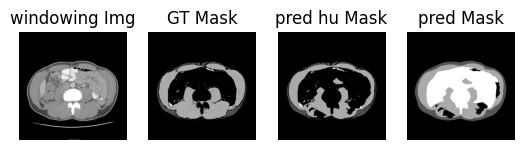

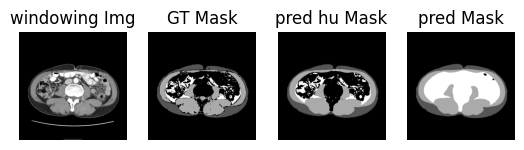

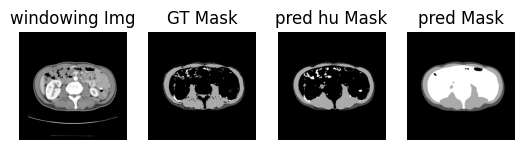

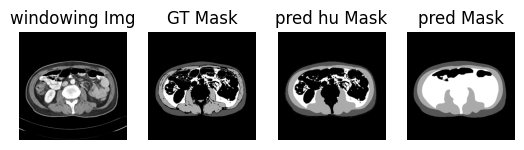

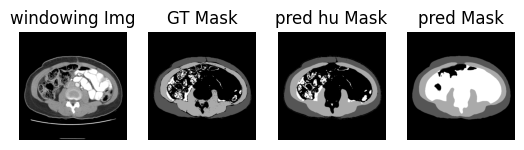

...

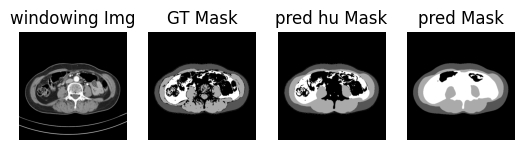

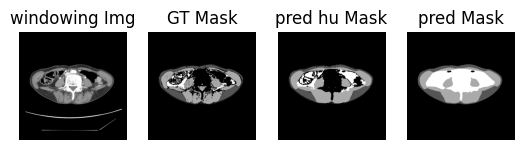

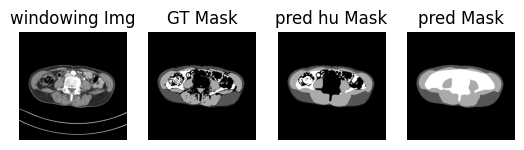

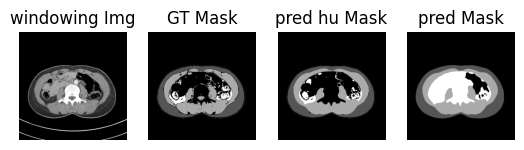

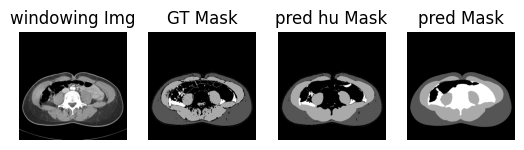

C:\Users\qwe14\anaconda3\envs\timm_model\Lib\site-packages\pydicom\charset.py:754: UserWarning: Unknown encoding 'ISO_IR 149' - using default encoding instead
  _warn_about_invalid_encoding(encoding)


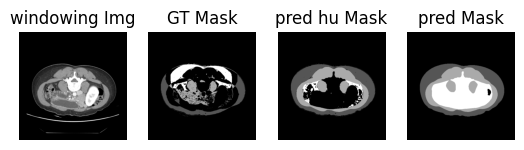

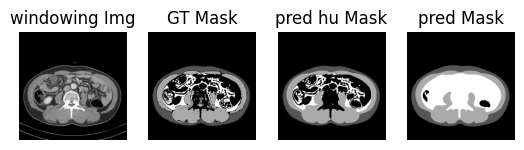

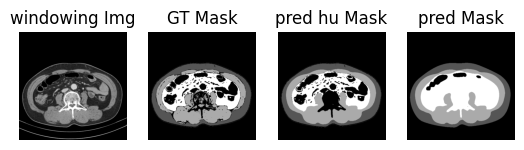

C:\Users\qwe14\anaconda3\envs\timm_model\Lib\site-packages\pydicom\charset.py:754: UserWarning: Unknown encoding 'ISO_IR 149' - using default encoding instead
  _warn_about_invalid_encoding(encoding)


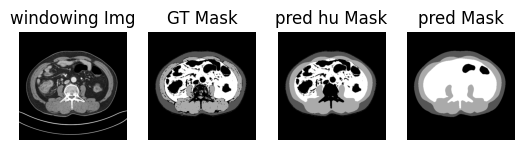

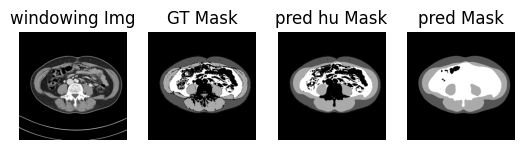

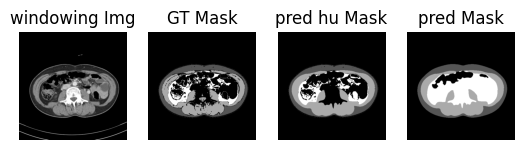

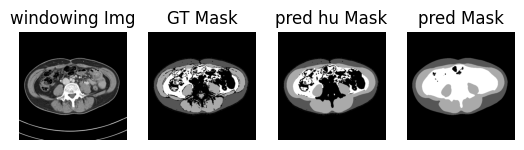

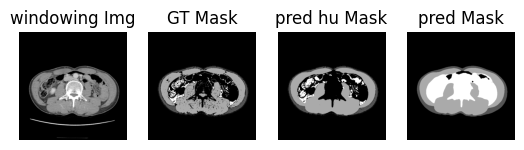

...

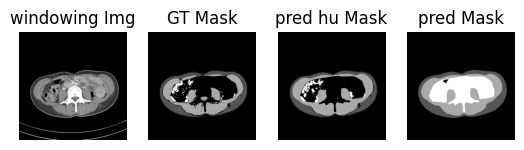

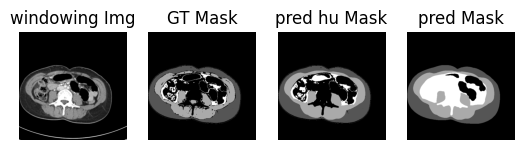

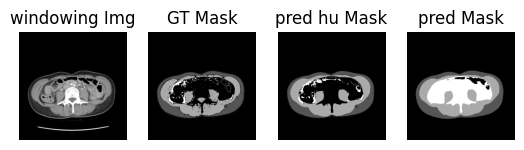

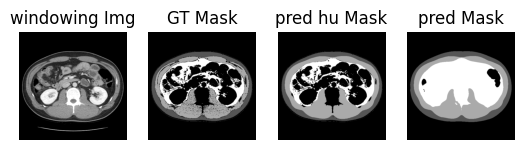

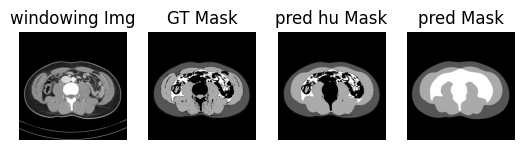

output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03602.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03612.png


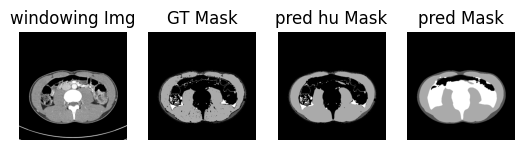

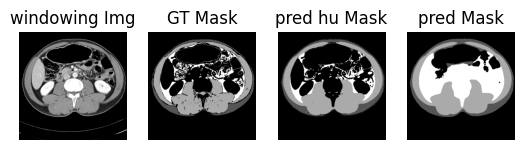

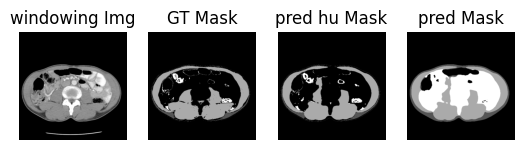

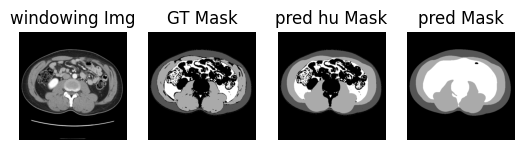

output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03662.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03672.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03682.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03692.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03702.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03712.png


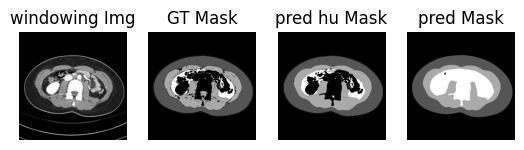

output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03732.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03742.png


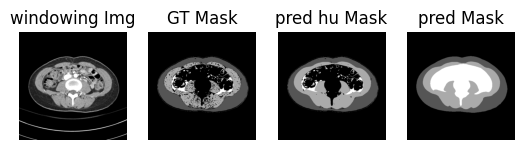

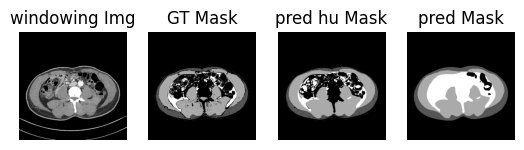

output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03772.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03782.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03792.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03802.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03812.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03822.png


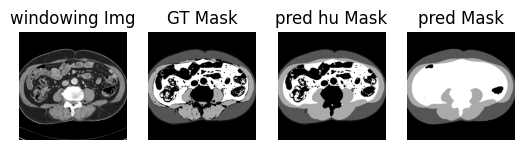

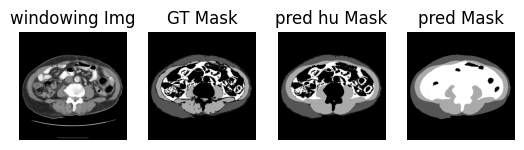

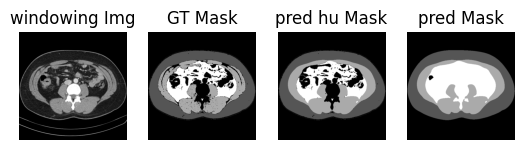

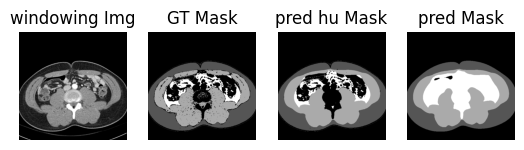

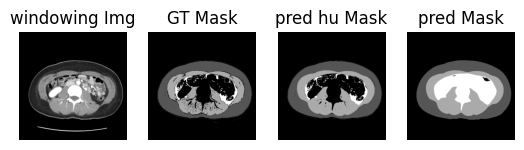

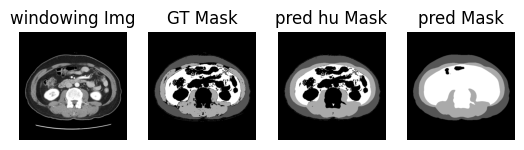

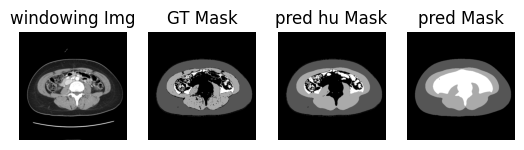

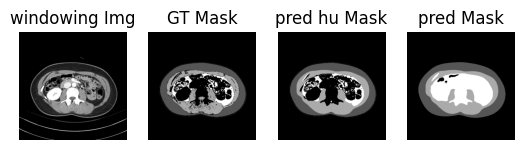

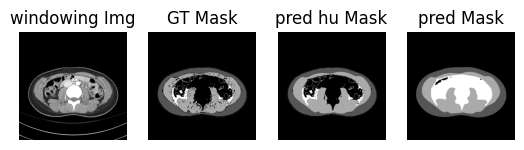

output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03922.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03932.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03942.png


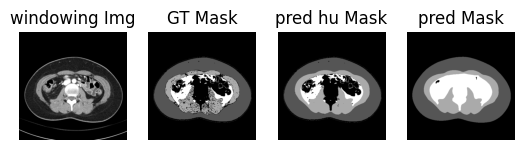

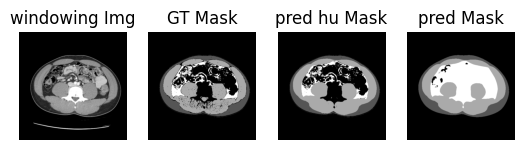

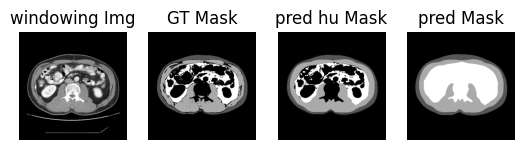

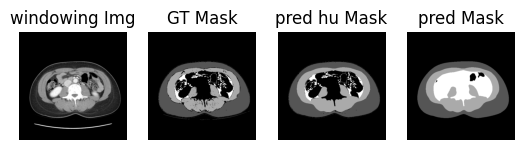

output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-03992.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-04002.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-04012.png


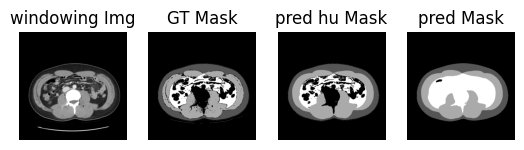

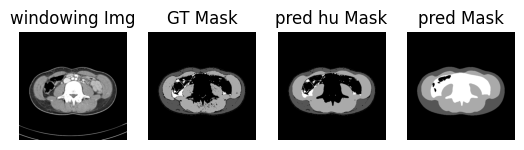

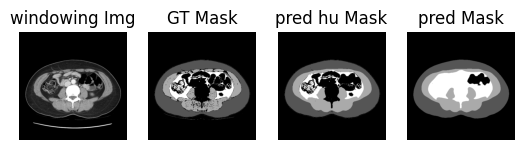

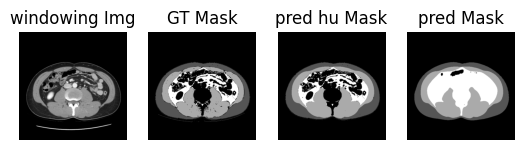

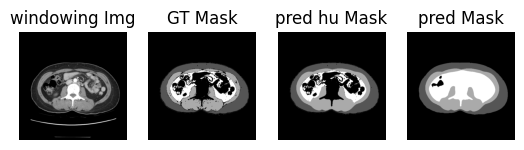

...

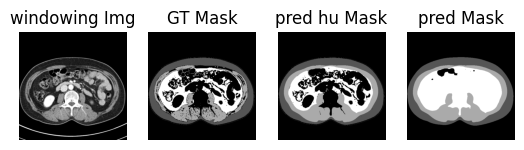

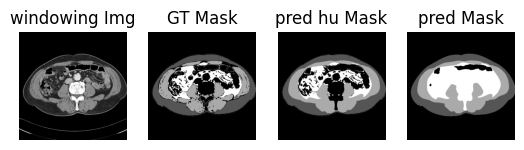

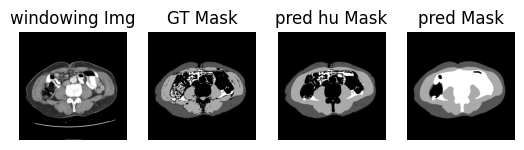

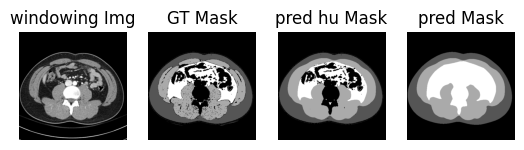

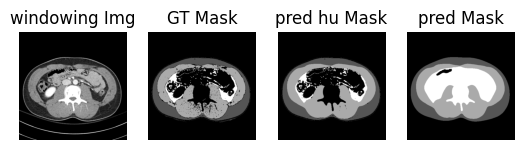

output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-04142.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-04152.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-04162.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-04172.png
output_mask NoneC:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs\img-04182.png


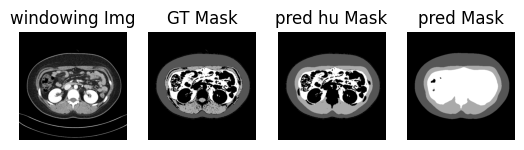

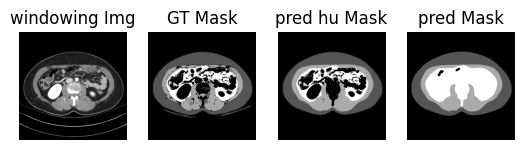

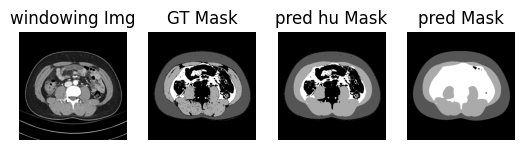

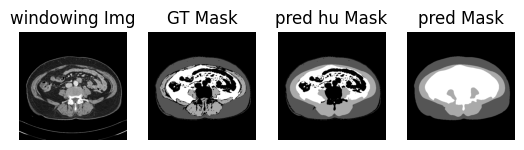

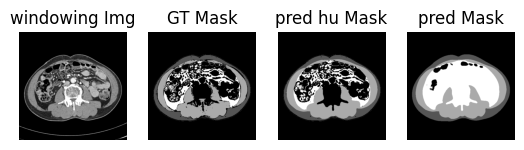

...

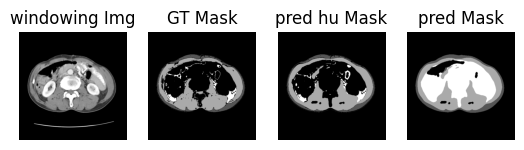

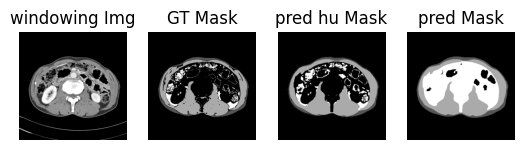

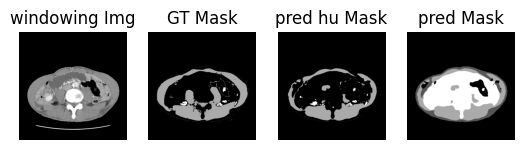

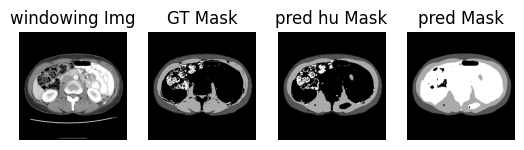

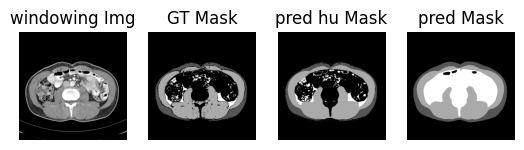

In [20]:
pred_mask_home = r'C:\Users\qwe14\0.code\nnUNet\nnUNet_results\Dataset122_MR\nnUNetTrainer__nnUNetPlans__2d\fold_5'
gt_mask_home = r'C:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\labelsTs'
gt_img_home = r'C:\Users\qwe14\0.code\nnUNet\nnUNet_raw\Dataset122_MRtest\imagesTs'

iou_list = []
acc_list = []
f1_macro_list = []
f1_micro_list = []
# ['C:\\Users\\qwe14\\0.code\\sarcopenia\\data_train_raw\\#AsanNas\\SarcopeniaCase1/20061220_DCM\\00040.dcm', 'C:\\Users\\qwe14\\0.code\\sarcopenia\\data_test\\masks\\00001_20061220.png']
for idx, (dcm_path, mask_path) in enumerate(test_set):
    mask_num = int(mask_path[-18:-13])
    img_path = f"{gt_img_home}\\img-{mask_num:05d}_0000.png"
    gt_mask_path = f"{gt_mask_home}\\img-{mask_num:05d}.png"
    pred_mask_path = f"{pred_mask_home}\\img-{mask_num:05d}.png"
    masks = hu_mask(dcm_path, img_path, gt_mask_path, pred_mask_path)
    gm_mask, pm_mask = masks
    if gm_mask is not None:
        iou_list.append(calculate_iou(pm_mask, gm_mask))
        f1_micro, f1_macro, acc = calculate_binary_metrics(pm_mask, gm_mask)
        acc_list.append(acc)
        f1_micro_list.append(f1_micro)
        f1_macro_list.append(f1_macro)

In [21]:
print(f"IoU: {np.mean(iou_list)}")
print(f"f1_macro score: {np.mean(f1_macro_list)}")
print(f"f1_micro score: {np.mean(f1_micro_list)}")
print(f"accuacy: {np.mean(acc_list)}")

IoU: 0.8536284178059751
f1_macro score: 0.919161017746382
f1_micro score: 0.9582923056065351
accuacy: 0.9582923056065351
